In [31]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2 as cv
from skimage import color
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, accuracy_score
from sklearn.model_selection import KFold
from tensorflow.keras.callbacks import ModelCheckpoint
import os
from sklearn.model_selection import train_test_split

### Load Data

In [37]:
x_train = np.load("../data/images/images_train.npy") / 255.0
y_train = np.load("../data/images/label_ids_train.npy")

x_test = np.load("../data/images/images_test.npy") / 255.0
y_test = np.load("../data/images/label_ids_test.npy")

{0: 'spiral',
 : 'greenstick',
 : 'comminuted',
 : 'avulsion'
}

### Bounding Box Plotting Function

In [38]:
def plot_images_with_bb(start, stop, bounding_box, x_train):

    for i in range(start, stop):

        if not bounding_box[i].any():
            continue

        img = x_train[i].reshape((512, 512, 3))
                                 
        # Create figure and axes
        fig, ax = plt.subplots()

        kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(35,35))

        # Top Hat Transform
        topHat = cv.morphologyEx(img, cv.MORPH_TOPHAT, kernel)
        
        # Black Hat Transform
        blackHat = cv.morphologyEx(img, cv.MORPH_BLACKHAT, kernel)
        
        res = img + topHat - blackHat

        plt.title(f'Image {i}')

        # Display the image
        ax.imshow(img, cmap='gray')
        
        # Create a Rectangle patch
        rect = patches.Rectangle((bounding_box[i][0], bounding_box[i][1]), 
                                 bounding_box[i][2], bounding_box[i][3], linewidth=1, edgecolor='r', facecolor='none')
        
        # Add the patch to the Axes
        ax.add_patch(rect)

### Initialize Bounding Box Arrays

In [39]:
bounding_box = np.zeros((x_train.shape[0], 4))
bounding_box_test = np.zeros((x_test.shape[0], 4))

### Spiral Fractures

/var/folders/5_/jqwpc7c52vd3nf9l7vkqwj480000gn/T/ipykernel_45375/2158507484.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


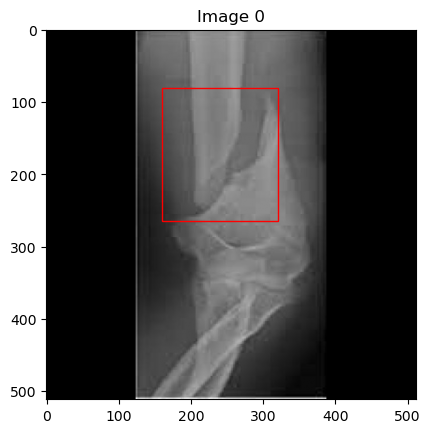

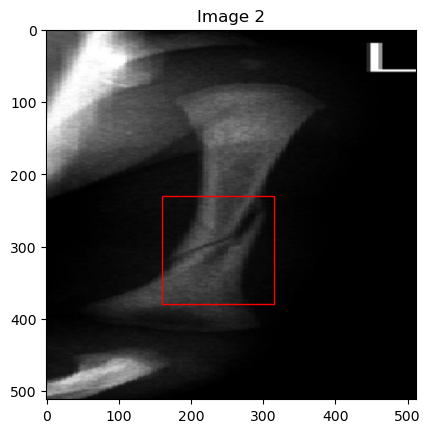

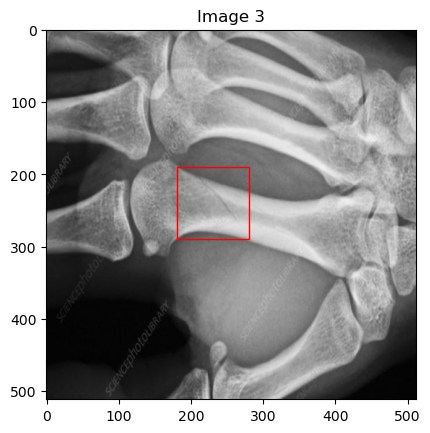

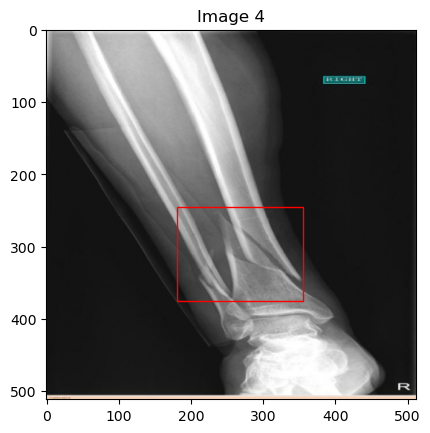

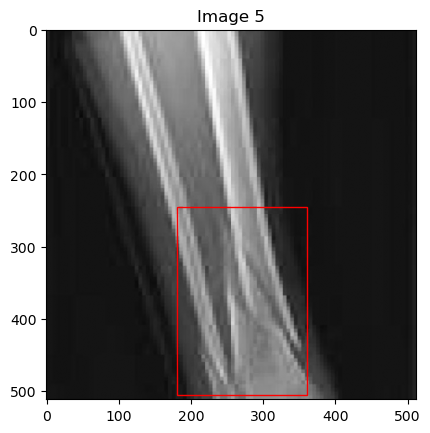

...

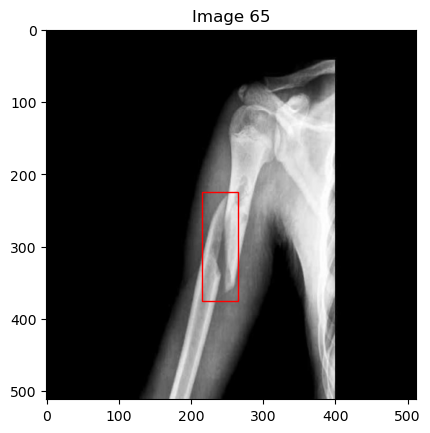

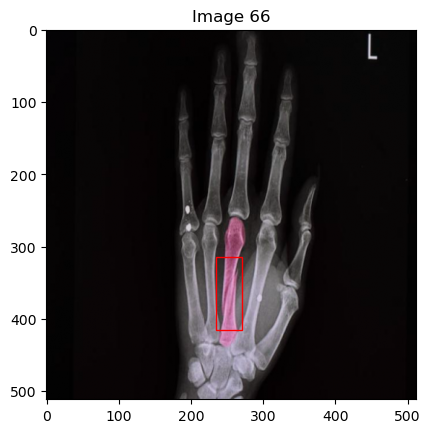

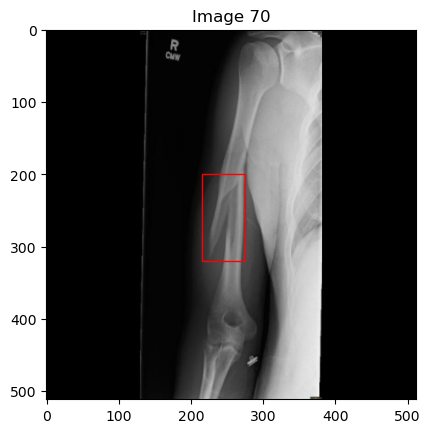

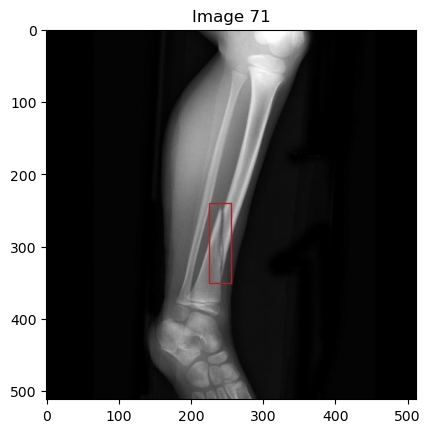

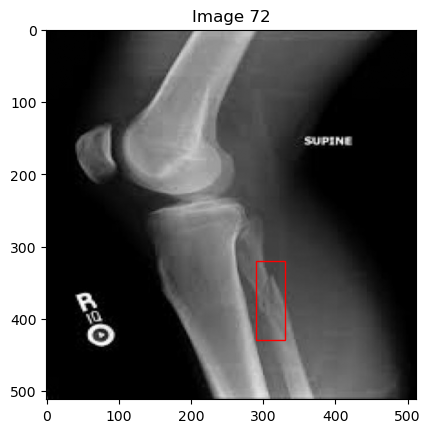

In [40]:
# Spiral Fracture
# Train
bounding_box[0] = np.array([160, 80, 160, 185])
bounding_box[2] = np.array([160, 230, 155, 150])
bounding_box[3] = np.array([180, 190, 100, 100])
bounding_box[4] = np.array([180, 245, 175, 130])
bounding_box[5] = np.array([180, 245, 180, 260])
bounding_box[6] = np.array([130, 255, 100, 145])
bounding_box[7] = np.array([200, 245, 75, 160])
bounding_box[10] = np.array([230, 220, 70, 220])
bounding_box[11] = np.array([160, 70, 170, 190])
bounding_box[12] = np.array([230, 320, 40, 100])
bounding_box[14] = np.array([180, 230, 80, 130])
bounding_box[15] = np.array([365, 100, 90, 250])
bounding_box[16] = np.array([240, 240, 70, 240])
bounding_box[17] = np.array([90, 120, 150, 150])
bounding_box[19] = np.array([130, 100, 50, 70])
bounding_box[21] = np.array([300, 50, 130, 290])
bounding_box[23] = np.array([360, 360, 120, 110])
bounding_box[24] = np.array([240, 240, 50, 140])
bounding_box[25] = np.array([200, 240, 160, 140])
bounding_box[28] = np.array([170, 70, 160, 190])
bounding_box[29] = np.array([230, 70, 80, 190])
bounding_box[30] = np.array([240, 190, 60, 80])
bounding_box[31] = np.array([250, 210, 60, 270])
bounding_box[33] = np.array([170, 180, 60, 60])
bounding_box[34] = np.array([230, 80, 135, 155])
bounding_box[35] = np.array([270, 310, 65, 55])
bounding_box[36] = np.array([280, 40, 130, 190])
bounding_box[37] = np.array([215, 200, 60, 120])
bounding_box[41] = np.array([140, 20, 270, 270])
bounding_box[42] = np.array([140, 140, 75, 100])
bounding_box[44] = np.array([180, 40, 100, 130])
bounding_box[46] = np.array([220, 380, 100, 130])
bounding_box[47] = np.array([180, 260, 70, 165])
bounding_box[48] = np.array([280, 330, 70, 115])
bounding_box[50] = np.array([250, 230, 50, 100])
bounding_box[51] = np.array([220, 180, 50, 80])
bounding_box[52] = np.array([210, 250, 60, 140])
bounding_box[53] = np.array([230, 210, 40, 100])
bounding_box[54] = np.array([250, 320, 100, 70])
bounding_box[57] = np.array([100, 130, 120, 150])
bounding_box[58] = np.array([300, 350, 35, 30])
bounding_box[59] = np.array([220, 250, 120, 120])
bounding_box[60] = np.array([240, 185, 40, 70])
bounding_box[61] = np.array([200, 270, 40, 90])
bounding_box[62] = np.array([290, 190, 60, 100])
bounding_box[65] = np.array([215, 225, 50, 150])
bounding_box[66] = np.array([235, 315, 35, 100])
bounding_box[70] = np.array([215, 200, 60, 120])
bounding_box[71] = np.array([225, 240, 30, 110])
bounding_box[72] = np.array([290, 320, 40, 110])
bounding_box[73] = np.array([150, 10, 180, 310])

plot_images_with_bb(0, 73, bounding_box, x_train)

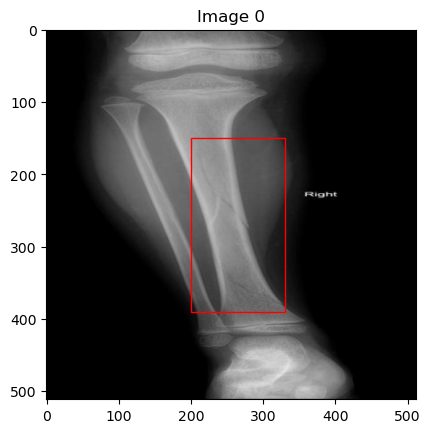

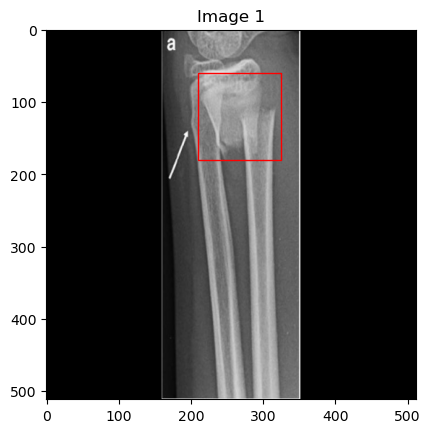

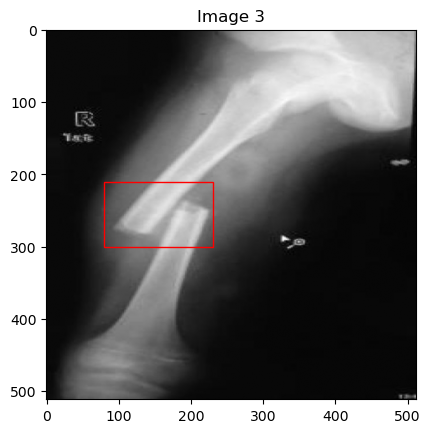

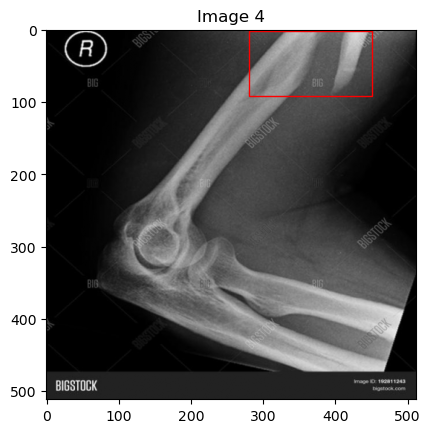

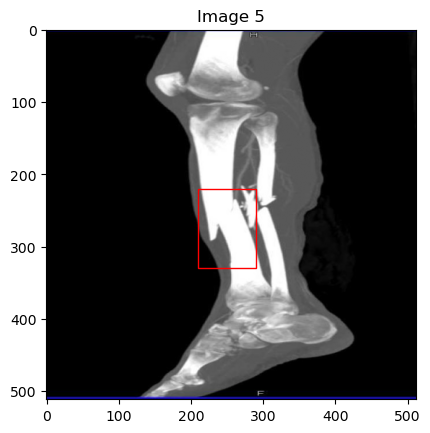

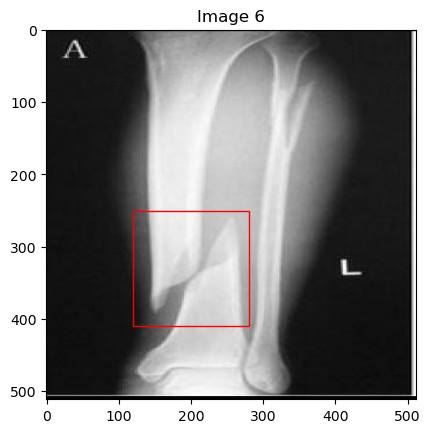

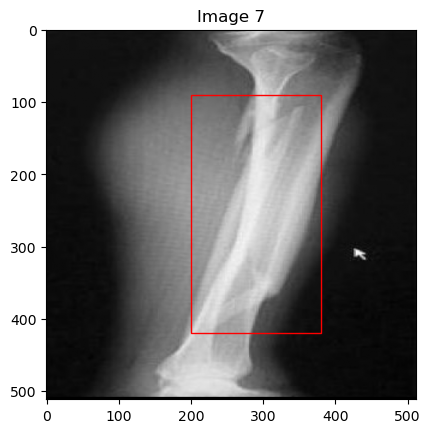

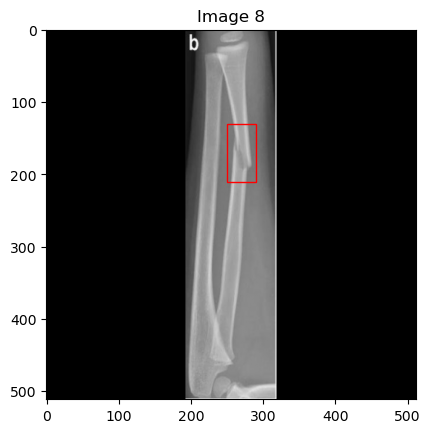

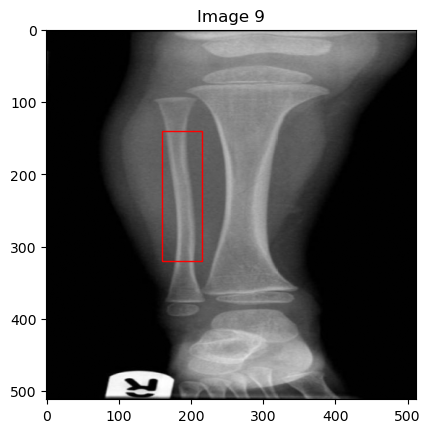

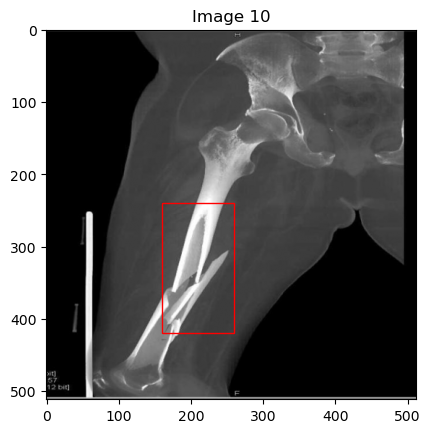

In [41]:
# Spiral Fracture
# Test
bounding_box_test[0] = np.array([200, 150, 130, 240])
bounding_box_test[1] = np.array([210, 60, 115, 120])
bounding_box_test[3] = np.array([80, 210, 150, 90])
bounding_box_test[4] = np.array([280, 1, 170, 90])
bounding_box_test[5] = np.array([210, 220, 80, 110])
bounding_box_test[6] = np.array([120, 250, 160, 160])
bounding_box_test[7] = np.array([200, 90, 180, 330])
bounding_box_test[8] = np.array([250, 130, 40, 80])
bounding_box_test[9] = np.array([160, 140, 55, 180])
bounding_box_test[10] = np.array([160, 240, 100, 180])
bounding_box_test[11] = np.array([230, 200, 40, 160])

plot_images_with_bb(0, 11, bounding_box_test, x_test)

### Comminuted Fractures

/var/folders/5_/jqwpc7c52vd3nf9l7vkqwj480000gn/T/ipykernel_45375/2158507484.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


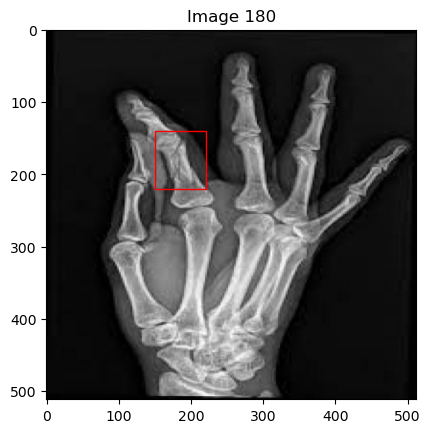

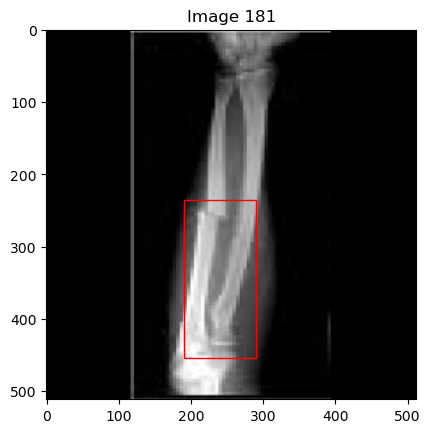

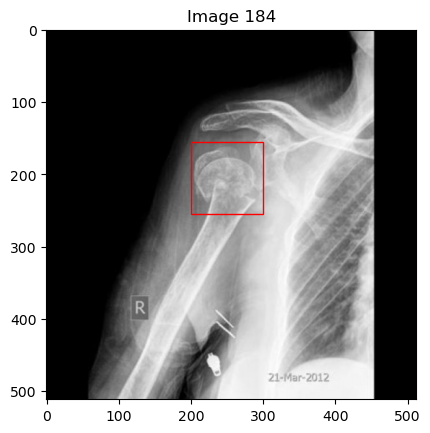

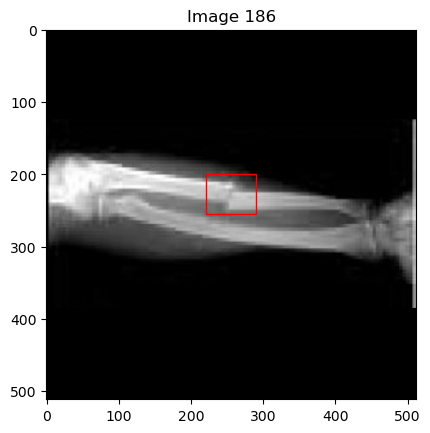

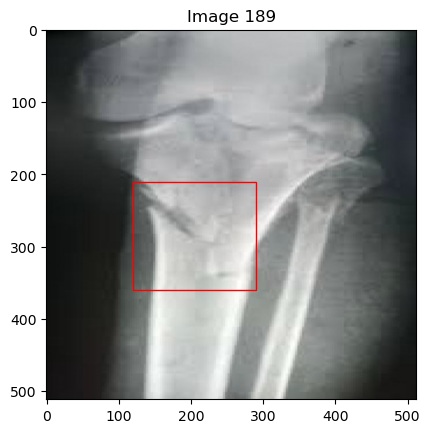

...

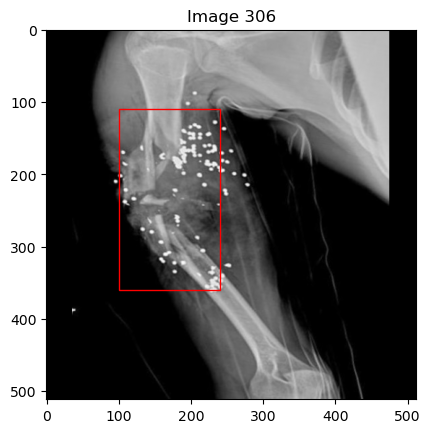

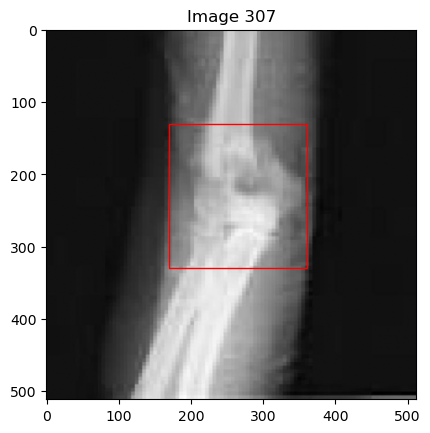

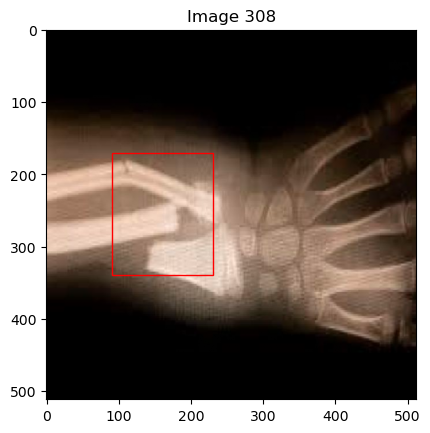

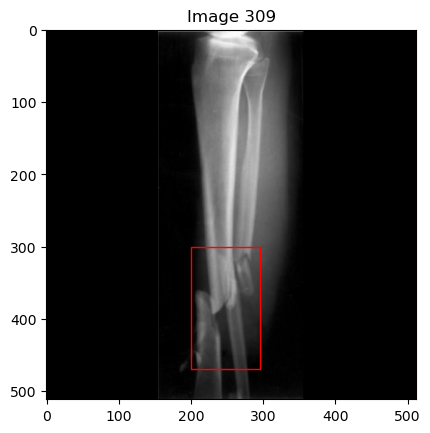

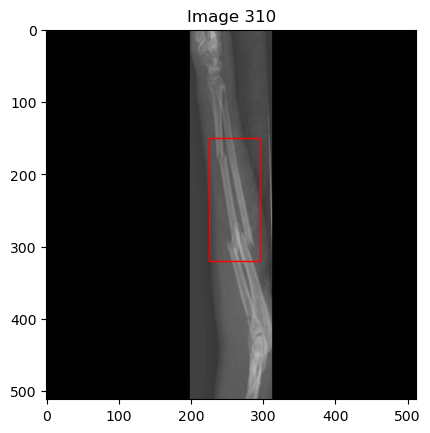

In [42]:
# Comminuted Fracture
# Train
bounding_box[180] = np.array([150, 140, 70, 80])
bounding_box[181] = np.array([190, 235, 100, 220])
bounding_box[184] = np.array([200, 155, 100, 100])
bounding_box[186] = np.array([220, 200, 70, 55])
bounding_box[189] = np.array([120, 210, 170, 150])
bounding_box[190] = np.array([210, 150, 120, 260])
bounding_box[192] = np.array([195, 130, 90, 80])
bounding_box[193] = np.array([195, 190, 135, 180])
bounding_box[194] = np.array([140, 30, 150, 280])
bounding_box[196] = np.array([300, 200, 100, 220])
bounding_box[197] = np.array([190, 180, 140, 200])
bounding_box[200] = np.array([190, 180, 140, 280])
bounding_box[201] = np.array([300, 200, 100, 150])
bounding_box[202] = np.array([190, 20, 140, 300])
bounding_box[203] = np.array([190, 10, 100, 340])
bounding_box[205] = np.array([90, 330, 190, 170])
bounding_box[207] = np.array([210, 90, 240, 410])
bounding_box[208] = np.array([120, 110, 240, 280])
bounding_box[209] = np.array([170, 200, 145, 210])
bounding_box[211] = np.array([200, 330, 50, 70])
bounding_box[212] = np.array([170, 100, 150, 170])
bounding_box[215] = np.array([280, 320, 140, 140])
bounding_box[216] = np.array([190, 200, 90, 170])
bounding_box[218] = np.array([250, 5, 120, 280])
bounding_box[219] = np.array([240, 140, 120, 220])
bounding_box[220] = np.array([260, 300, 60, 120])
bounding_box[221] = np.array([90, 170, 170, 180])
bounding_box[222] = np.array([250, 210, 150, 160])
bounding_box[224] = np.array([190, 220, 60, 70])
bounding_box[225] = np.array([220, 100, 65, 230])
bounding_box[227] = np.array([220, 50, 120, 80])
bounding_box[228] = np.array([170, 200, 100, 90])
bounding_box[229] = np.array([410, 200, 80, 70])
bounding_box[231] = np.array([210, 200, 100, 60])
bounding_box[232] = np.array([80, 200, 250, 200])
bounding_box[233] = np.array([220, 5, 170, 240])
bounding_box[235] = np.array([200, 150, 170, 260])
bounding_box[236] = np.array([85, 330, 280, 160])
bounding_box[237] = np.array([130, 70, 80, 220])
bounding_box[243] = np.array([140, 170, 185, 170])
bounding_box[244] = np.array([180, 170, 190, 130])
bounding_box[245] = np.array([220, 180, 190, 110])
bounding_box[246] = np.array([320, 10, 100, 180])
bounding_box[247] = np.array([110, 140, 330, 240])
bounding_box[248] = np.array([350, 130, 140, 70])
bounding_box[249] = np.array([250, 190, 170, 170])
bounding_box[251] = np.array([145, 170, 200, 170])
bounding_box[252] = np.array([190, 170, 120, 240])
bounding_box[253] = np.array([230, 210, 200, 190])
bounding_box[255] = np.array([80, 280, 200, 230])
bounding_box[257] = np.array([150, 250, 150, 80])
bounding_box[258] = np.array([20, 190, 230, 230])
bounding_box[259] = np.array([250, 240, 210, 245])
bounding_box[260] = np.array([250, 200, 140, 145])
bounding_box[261] = np.array([360, 210, 90, 130])
bounding_box[262] = np.array([130, 280, 110, 80])
bounding_box[264] = np.array([140, 100, 190, 280])
bounding_box[265] = np.array([100, 80, 300, 330])
bounding_box[268] = np.array([250, 250, 230, 255])
bounding_box[271] = np.array([260, 260, 115, 200])
bounding_box[274] = np.array([100, 100, 300, 230])
bounding_box[275] = np.array([50, 260, 130, 180])
bounding_box[276] = np.array([240, 10, 140, 290])
bounding_box[277] = np.array([160, 130, 110, 160])
bounding_box[278] = np.array([180, 250, 85, 160])
bounding_box[279] = np.array([230, 190, 190, 220])
bounding_box[280] = np.array([230, 145, 150, 230])
bounding_box[281] = np.array([220, 230, 70, 50])
bounding_box[282] = np.array([130, 230, 290, 180])
bounding_box[284] = np.array([210, 180, 130, 80])
bounding_box[286] = np.array([215, 180, 100, 80])
bounding_box[287] = np.array([190, 160, 120, 160])
bounding_box[288] = np.array([160, 290, 160, 200])
bounding_box[291] = np.array([90, 300, 260, 85])
bounding_box[292] = np.array([170, 10, 160, 300])
bounding_box[293] = np.array([170, 230, 160, 260])
bounding_box[294] = np.array([10, 180, 150, 220])
bounding_box[295] = np.array([170, 220, 150, 280])
bounding_box[296] = np.array([180, 350, 50, 70])
bounding_box[299] = np.array([240, 210, 150, 150])
bounding_box[300] = np.array([190, 180, 130, 250])
bounding_box[304] = np.array([130, 220, 300, 70])
bounding_box[305] = np.array([235, 160, 130, 100])
bounding_box[306] = np.array([100, 110, 140, 250])
bounding_box[307] = np.array([170, 130, 190, 200])
bounding_box[308] = np.array([90, 170, 140, 170])
bounding_box[309] = np.array([200, 300, 95, 170])
bounding_box[310] = np.array([225, 150, 70, 170])

plot_images_with_bb(180, 311, bounding_box, x_train)

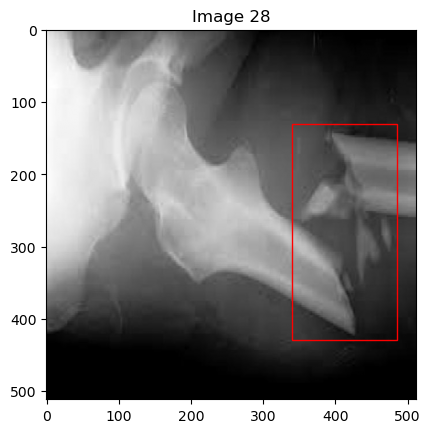

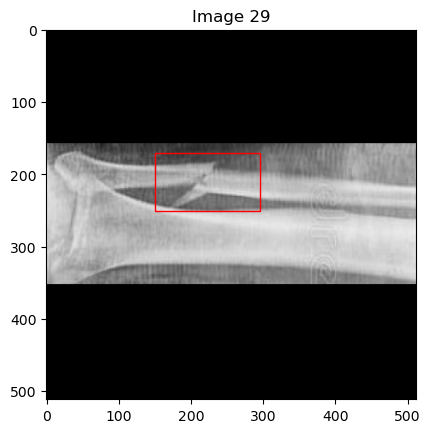

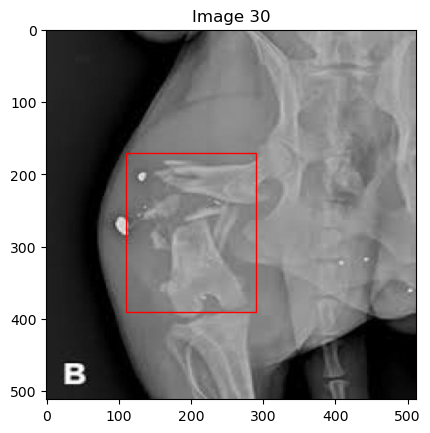

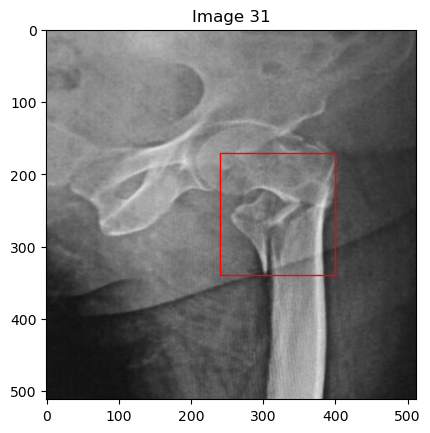

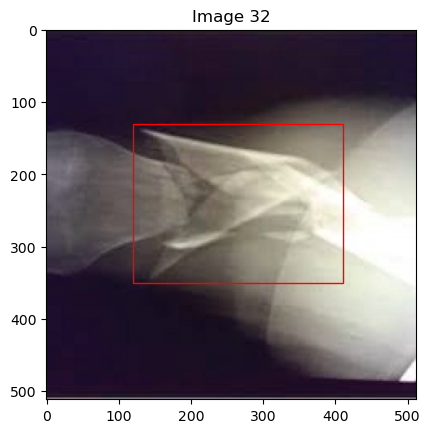

...

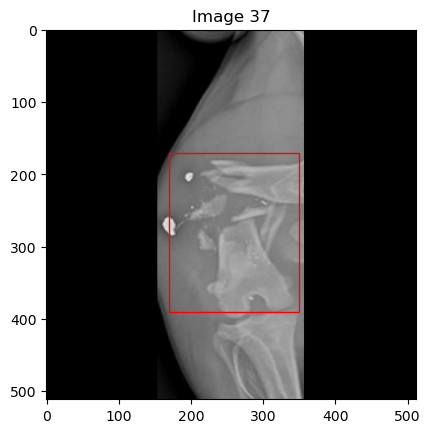

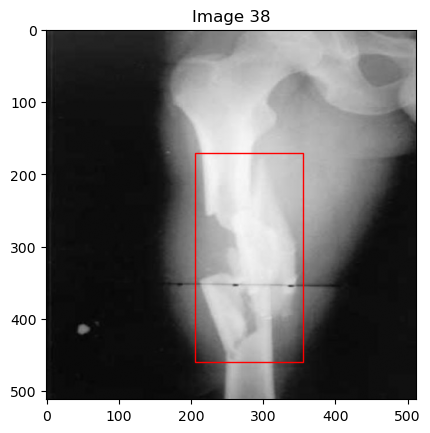

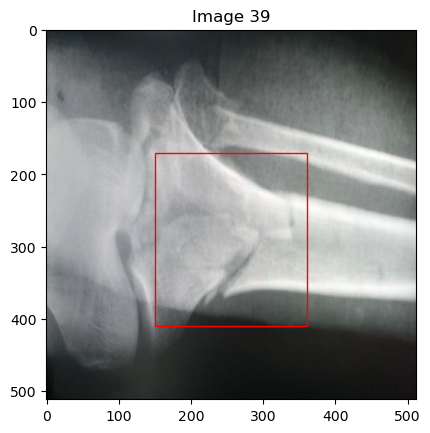

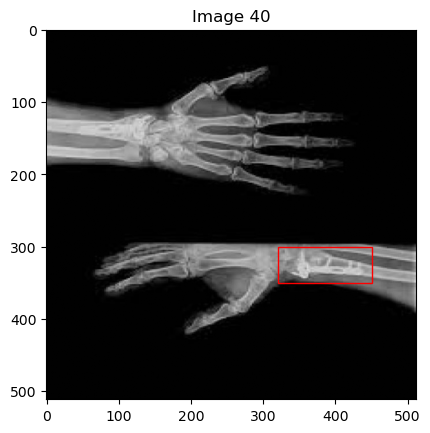

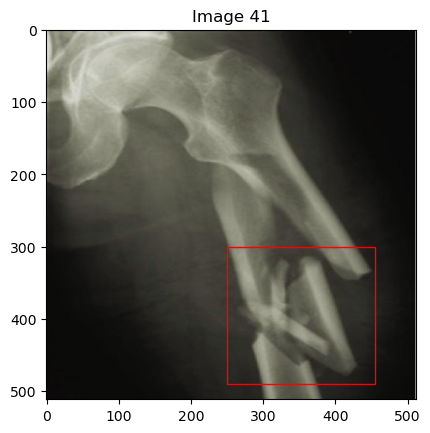

In [43]:
# Comminuted Fracture
# Test
bounding_box_test[28] = np.array([340, 130, 145, 300])
bounding_box_test[29] = np.array([150, 170, 145, 80])
bounding_box_test[30] = np.array([110, 170, 180, 220])
bounding_box_test[31] = np.array([240, 170, 160, 170])
bounding_box_test[32] = np.array([120, 130, 290, 220])
bounding_box_test[33] = np.array([20, 120, 90, 90])
bounding_box_test[34] = np.array([150, 100, 210, 230])
bounding_box_test[35] = np.array([270, 170, 80, 110])
bounding_box_test[36] = np.array([200, 180, 265, 180])
bounding_box_test[37] = np.array([170, 170, 180, 220])
bounding_box_test[38] = np.array([205, 170, 150, 290])
bounding_box_test[39] = np.array([150, 170, 210, 240])
bounding_box_test[40] = np.array([320, 300, 130, 50])
bounding_box_test[41] = np.array([250, 300, 205, 190])

plot_images_with_bb(28, 42, bounding_box_test, x_test)

### Greenstick Fractures

/var/folders/5_/jqwpc7c52vd3nf9l7vkqwj480000gn/T/ipykernel_45375/2158507484.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


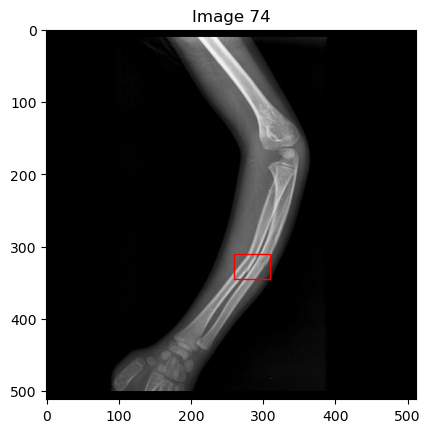

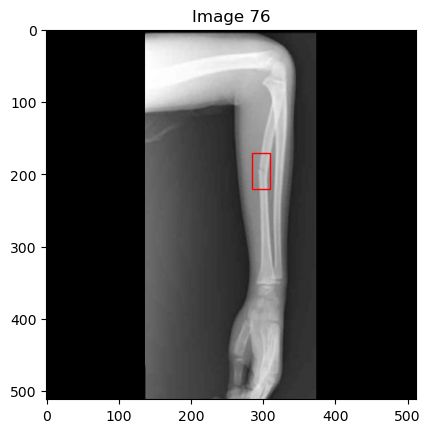

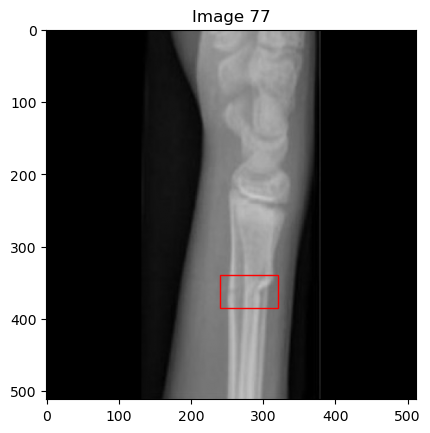

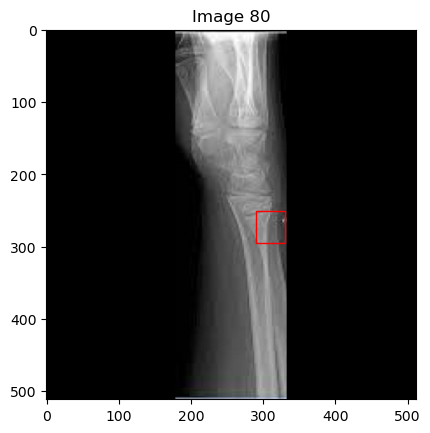

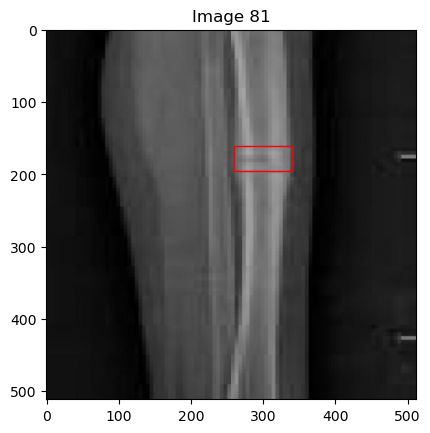

...

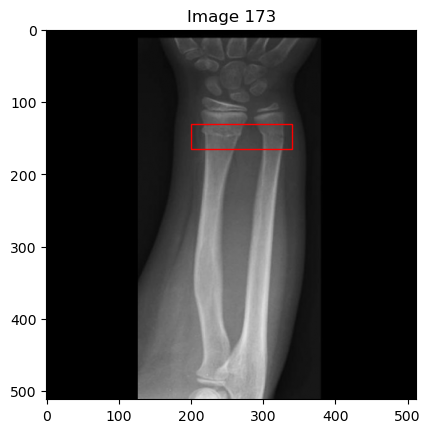

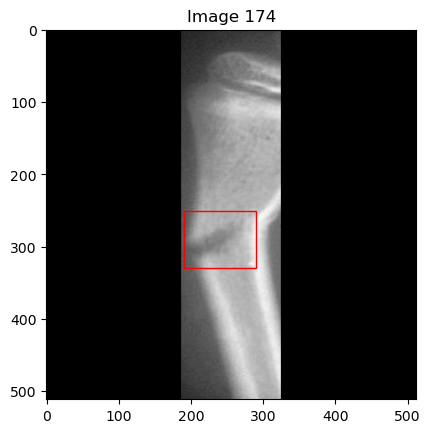

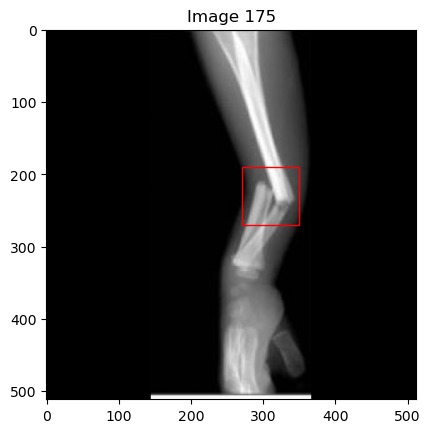

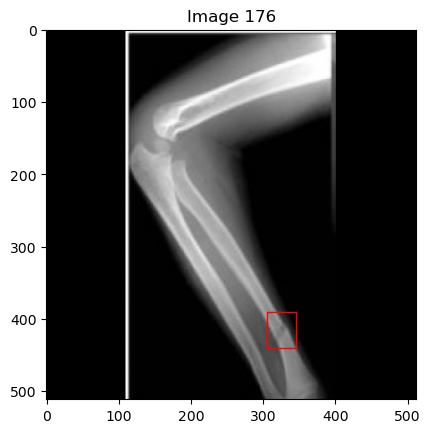

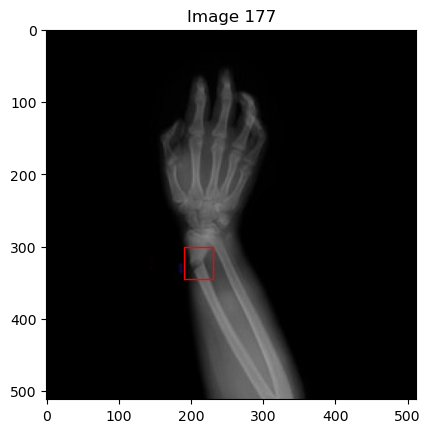

In [44]:
# Greenstick Fracture
# Train
bounding_box[74] = np.array([260, 310, 50, 35])
bounding_box[76] = np.array([285, 170, 25, 50])
bounding_box[77] = np.array([240, 340, 80, 45])
bounding_box[80] = np.array([290, 250, 40, 45])
bounding_box[81] = np.array([260, 160, 80, 35])
bounding_box[82] = np.array([245, 270, 55, 35])
bounding_box[83] = np.array([180, 210, 85, 65])
bounding_box[84] = np.array([160, 300, 210, 85])
bounding_box[85] = np.array([40, 160, 110, 120])
bounding_box[88] = np.array([120, 60, 70, 55])
bounding_box[89] = np.array([210, 230, 80, 55])
bounding_box[90] = np.array([320, 90, 65, 55])
bounding_box[91] = np.array([420, 235, 30, 30])
bounding_box[92] = np.array([315, 250, 30, 25])
bounding_box[93] = np.array([155, 210, 80, 90])
bounding_box[94] = np.array([250, 210, 40, 90])
bounding_box[95] = np.array([200, 300, 120, 85])
bounding_box[96] = np.array([230, 190, 110, 110])
bounding_box[97] = np.array([390, 160, 60, 50])
bounding_box[98] = np.array([30, 390, 100, 80])
bounding_box[99] = np.array([270, 250, 45, 40])
bounding_box[100] = np.array([160, 210, 55, 45])
bounding_box[101] = np.array([280, 335, 45, 45])
bounding_box[103] = np.array([225, 320, 45, 45])
bounding_box[104] = np.array([210, 190, 100, 120])
bounding_box[105] = np.array([220, 230, 65, 50])
bounding_box[106] = np.array([220, 310, 80, 45])
bounding_box[107] = np.array([160, 260, 60, 35])
bounding_box[108] = np.array([75, 260, 80, 90])
bounding_box[109] = np.array([220, 230, 80, 50])
bounding_box[111] = np.array([200, 360, 50, 50])
bounding_box[112] = np.array([180, 230, 100, 110])
bounding_box[113] = np.array([220, 180, 65, 40])
bounding_box[114] = np.array([210, 200, 55, 50])
bounding_box[115] = np.array([230, 330, 90, 50])
bounding_box[116] = np.array([220, 180, 70, 35])
bounding_box[117] = np.array([220, 320, 75, 40])
bounding_box[118] = np.array([230, 135, 60, 30])
bounding_box[119] = np.array([220, 210, 80, 50])
bounding_box[120] = np.array([160, 270, 220, 70])
bounding_box[122] = np.array([160, 310, 140, 180])
bounding_box[123] = np.array([110, 50, 120, 130])
bounding_box[124] = np.array([220, 200, 60, 40])
bounding_box[127] = np.array([265, 250, 70, 45])
bounding_box[128] = np.array([270, 195, 90, 35])
bounding_box[129] = np.array([190, 290, 100, 45])
bounding_box[130] = np.array([150, 230, 230, 110])
bounding_box[131] = np.array([270, 240, 50, 70])
bounding_box[132] = np.array([250, 350, 70, 80])
bounding_box[133] = np.array([200, 320, 100, 80])
bounding_box[134] = np.array([220, 160, 60, 40])
bounding_box[135] = np.array([390, 260, 50, 45])
bounding_box[136] = np.array([190, 320, 130, 45])
bounding_box[137] = np.array([300, 180, 40, 35])
bounding_box[139] = np.array([240, 270, 60, 35])
bounding_box[140] = np.array([170, 190, 40, 40])
bounding_box[141] = np.array([270, 110, 70, 60])
bounding_box[142] = np.array([270, 140, 75, 55])
bounding_box[143] = np.array([190, 220, 40, 30])
bounding_box[145] = np.array([230, 250, 80, 50])
bounding_box[148] = np.array([320, 90, 70, 50])
bounding_box[149] = np.array([160, 250, 70, 60])
bounding_box[151] = np.array([140, 210, 70, 60])
bounding_box[152] = np.array([180, 280, 110, 60])
bounding_box[154] = np.array([190, 240, 60, 70])
bounding_box[155] = np.array([200, 400, 90, 70])
bounding_box[156] = np.array([260, 230, 60, 90])
bounding_box[157] = np.array([190, 200, 80, 60])
bounding_box[158] = np.array([205, 300, 95, 60])
bounding_box[159] = np.array([210, 290, 135, 50])
bounding_box[160] = np.array([290, 220, 40, 55])
bounding_box[161] = np.array([250, 210, 40, 55])
bounding_box[163] = np.array([260, 270, 35, 55])
bounding_box[164] = np.array([190, 225, 50, 80])
bounding_box[165] = np.array([190, 150, 80, 100])
bounding_box[167] = np.array([170, 300, 110, 80])
bounding_box[169] = np.array([210, 260, 100, 70])
bounding_box[170] = np.array([180, 120, 70, 30])
bounding_box[171] = np.array([240, 210, 40, 30])
bounding_box[172] = np.array([240, 215, 80, 60])
bounding_box[173] = np.array([200, 130, 140, 35])
bounding_box[174] = np.array([190, 250, 100, 80])
bounding_box[175] = np.array([270, 190, 80, 80])
bounding_box[176] = np.array([305, 390, 40, 50])
bounding_box[177] = np.array([190, 300, 40, 45])

plot_images_with_bb(74, 178, bounding_box, x_train)

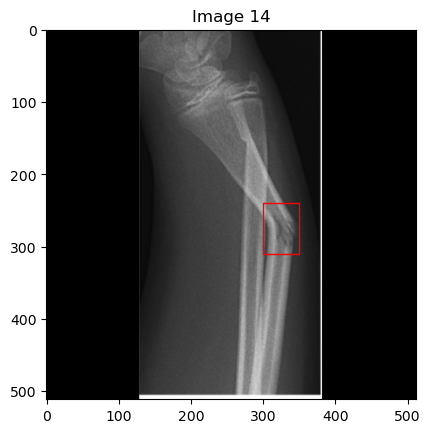

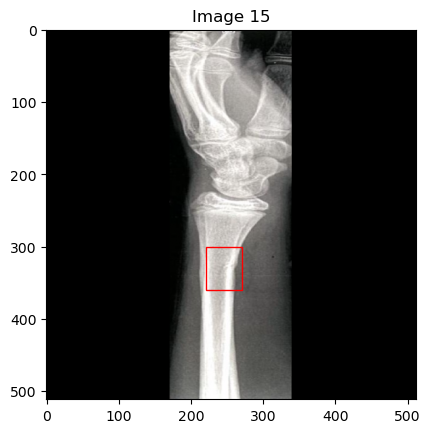

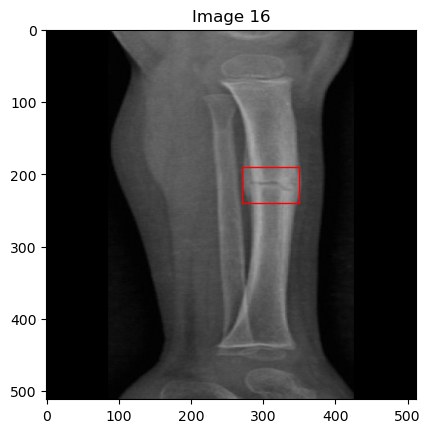

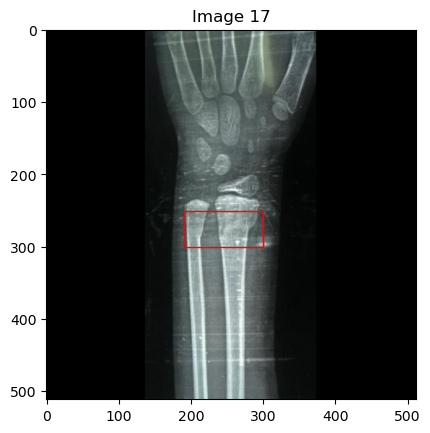

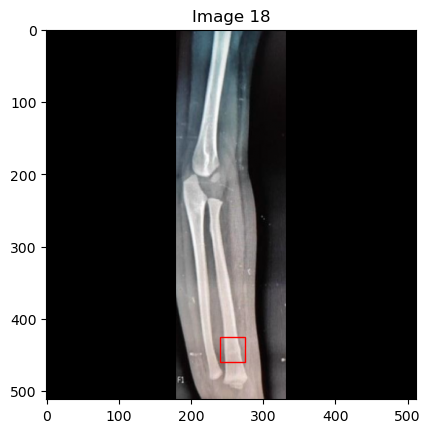

...

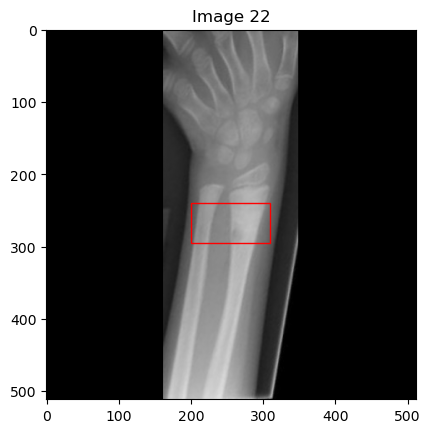

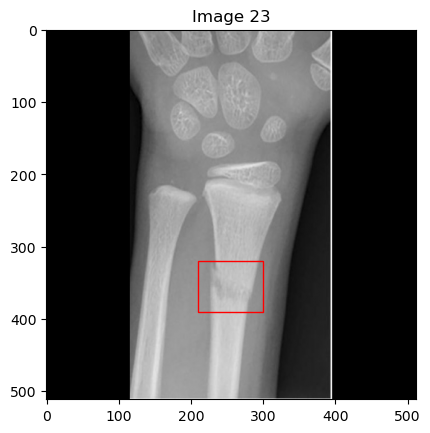

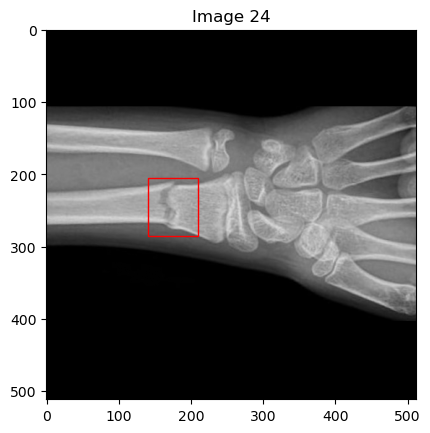

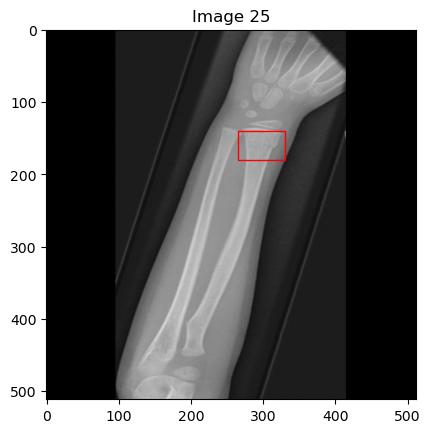

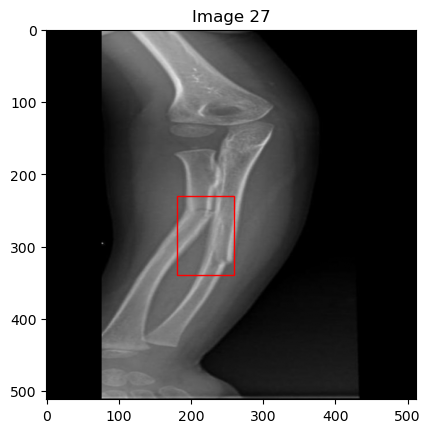

In [45]:
# Greenstick Fracture
# Test
bounding_box_test[14] = np.array([300, 240, 50, 70])
bounding_box_test[15] = np.array([220, 300, 50, 60])
bounding_box_test[16] = np.array([270, 190, 80, 50])
bounding_box_test[17] = np.array([190, 250, 110, 50])
bounding_box_test[18] = np.array([240, 425, 35, 35])
bounding_box_test[19] = np.array([180, 250, 100, 65])
bounding_box_test[20] = np.array([240, 200, 50, 55])
bounding_box_test[21] = np.array([220, 410, 60, 55])
bounding_box_test[22] = np.array([200, 240, 110, 55])
bounding_box_test[23] = np.array([210, 320, 90, 70])
bounding_box_test[24] = np.array([140, 205, 70, 80])
bounding_box_test[25] = np.array([265, 140, 65, 40])
bounding_box_test[27] = np.array([180, 230, 80, 110])

plot_images_with_bb(14, 28, bounding_box_test, x_test)

### Avulsion Fractures

/var/folders/5_/jqwpc7c52vd3nf9l7vkqwj480000gn/T/ipykernel_45375/2158507484.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


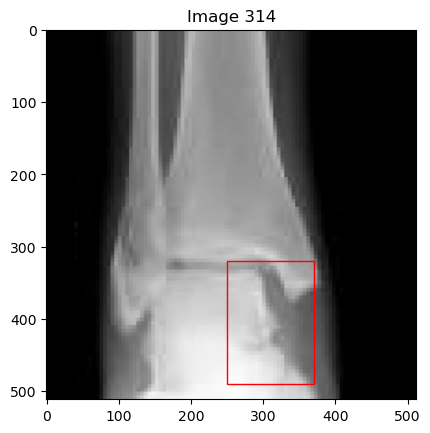

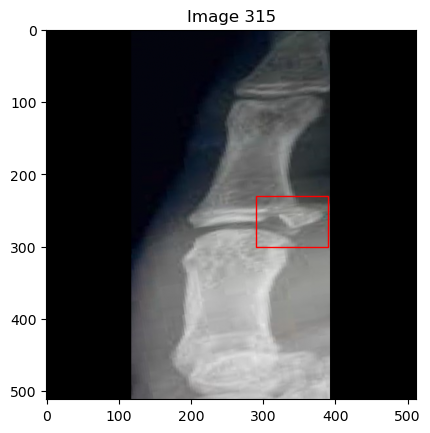

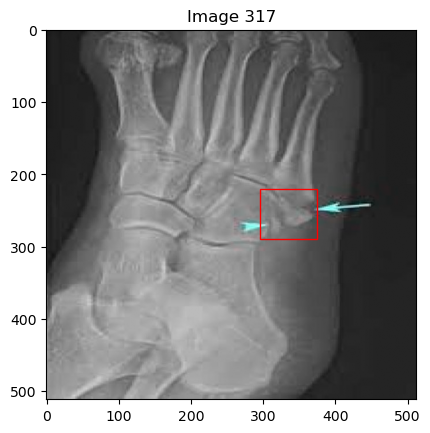

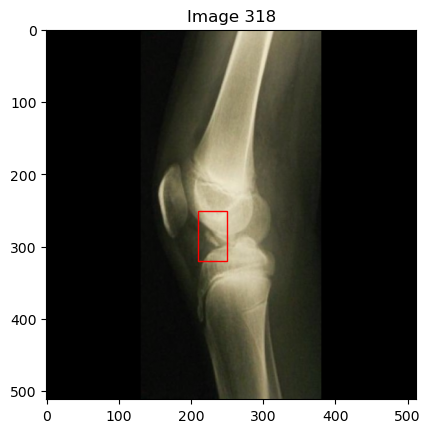

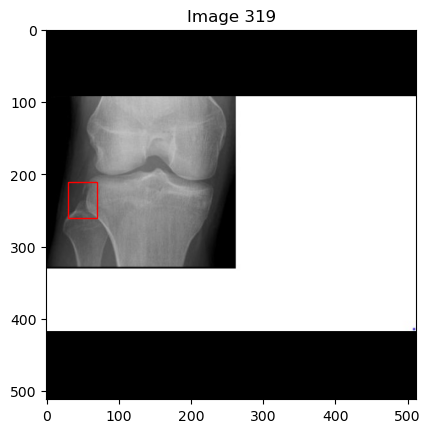

...

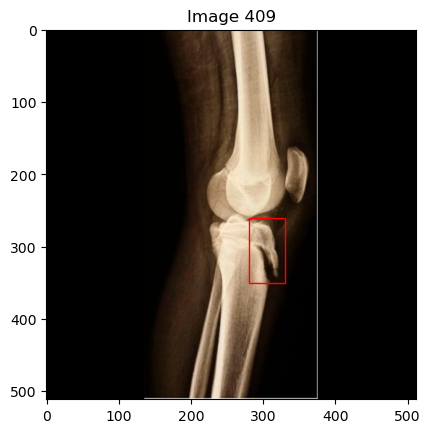

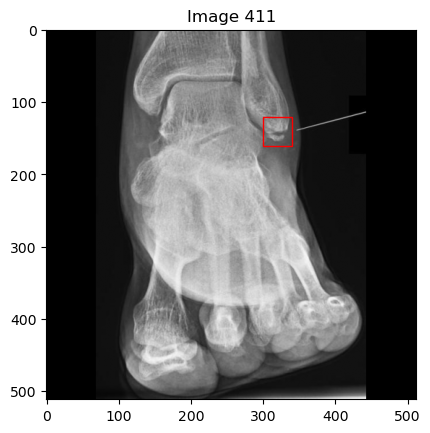

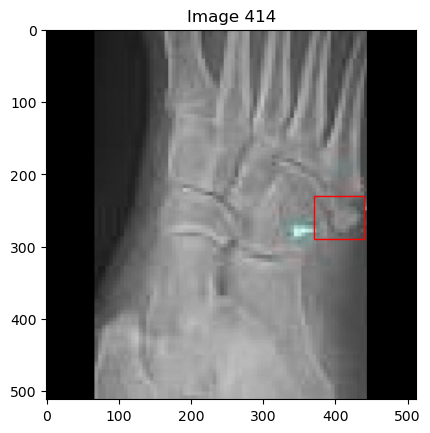

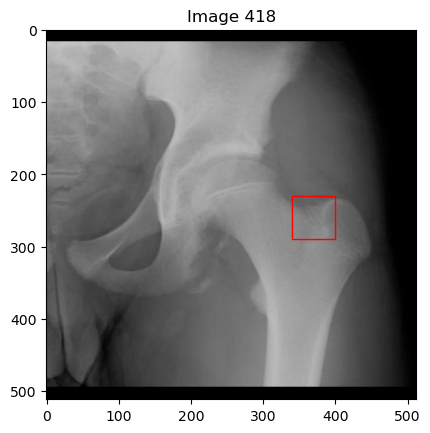

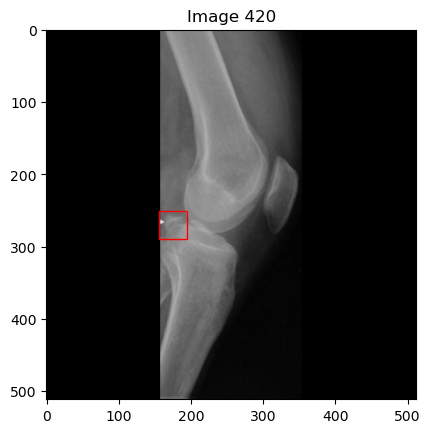

In [46]:
# Avulsion Fracture
# Train
bounding_box[314] = np.array([250, 320, 120, 170])
bounding_box[315] = np.array([290, 230, 100, 70])
bounding_box[317] = np.array([295, 220, 80, 70])
bounding_box[318] = np.array([210, 250, 40, 70])
bounding_box[319] = np.array([30, 210, 40, 50])
bounding_box[320] = np.array([150, 320, 70, 70])
bounding_box[322] = np.array([250, 270, 70, 70])
bounding_box[324] = np.array([190, 270, 30, 70])
bounding_box[325] = np.array([250, 330, 70, 70])
bounding_box[326] = np.array([180, 90, 70, 70])
bounding_box[327] = np.array([180, 90, 70, 70])
bounding_box[331] = np.array([160, 80, 70, 70])
bounding_box[333] = np.array([60, 250, 60, 70])
bounding_box[334] = np.array([200, 270, 100, 120])
bounding_box[335] = np.array([70, 110, 100, 70])
bounding_box[336] = np.array([70, 120, 70, 70])
bounding_box[339] = np.array([290, 150, 90, 100])
bounding_box[340] = np.array([180, 220, 70, 90])
bounding_box[341] = np.array([410, 270, 40, 70])
bounding_box[343] = np.array([310, 180, 110, 90])
bounding_box[347] = np.array([290, 200, 30, 90])
bounding_box[348] = np.array([65, 90, 45, 80])
bounding_box[349] = np.array([65, 130, 30, 30])
bounding_box[350] = np.array([190, 280, 40, 50])
bounding_box[351] = np.array([350, 220, 40, 70])
bounding_box[355] = np.array([270, 220, 40, 100])
bounding_box[358] = np.array([240, 330, 40, 90])
bounding_box[361] = np.array([260, 245, 70, 60])
bounding_box[362] = np.array([315, 55, 50, 40])
bounding_box[364] = np.array([315, 150, 50, 70])
bounding_box[365] = np.array([170, 220, 50, 80])
bounding_box[366] = np.array([360, 250, 80, 90])
bounding_box[367] = np.array([90, 450, 40, 50])
bounding_box[368] = np.array([220, 250, 70, 60])
bounding_box[369] = np.array([210, 280, 40, 40])
bounding_box[370] = np.array([400, 200, 85, 90])
bounding_box[371] = np.array([40, 260, 65, 80])
bounding_box[373] = np.array([150, 220, 100, 60])
bounding_box[374] = np.array([80, 190, 90, 170])
bounding_box[375] = np.array([150, 200, 50, 100])
bounding_box[378] = np.array([340, 140, 40, 90])
bounding_box[379] = np.array([160, 80, 40, 70])
bounding_box[382] = np.array([350, 210, 50, 120])
bounding_box[383] = np.array([70, 430, 60, 50])
bounding_box[385] = np.array([190, 180, 80, 50])
bounding_box[386] = np.array([190, 260, 60, 50])
bounding_box[387] = np.array([180, 110, 65, 70])
bounding_box[390] = np.array([250, 280, 40, 40])
bounding_box[391] = np.array([270, 90, 60, 80])
bounding_box[396] = np.array([230, 410, 60, 70])
bounding_box[397] = np.array([70, 240, 80, 80])
bounding_box[398] = np.array([260, 90, 130, 60])
bounding_box[399] = np.array([100, 280, 90, 60])
bounding_box[403] = np.array([80, 190, 90, 80])
bounding_box[404] = np.array([400, 260, 45, 70])
bounding_box[405] = np.array([90, 110, 70, 80])
bounding_box[406] = np.array([400, 380, 50, 70])
bounding_box[409] = np.array([280, 260, 50, 90])
bounding_box[411] = np.array([300, 120, 40, 40])
bounding_box[414] = np.array([370, 230, 70, 60])
bounding_box[418] = np.array([340, 230, 60, 60])
bounding_box[420] = np.array([155, 250, 40, 40])

plot_images_with_bb(314, 421, bounding_box, x_train)

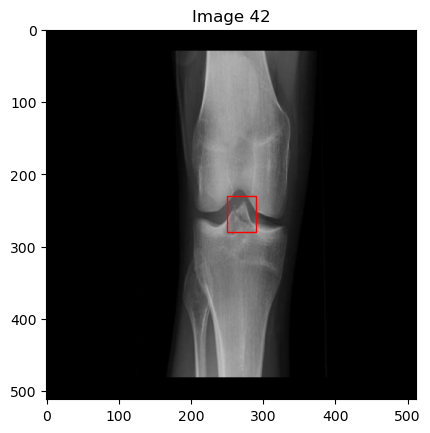

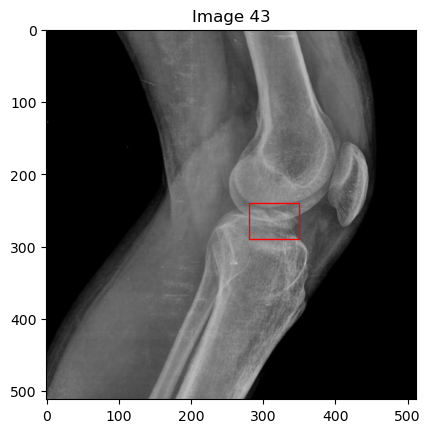

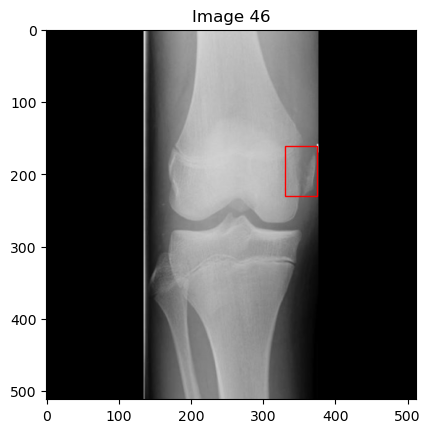

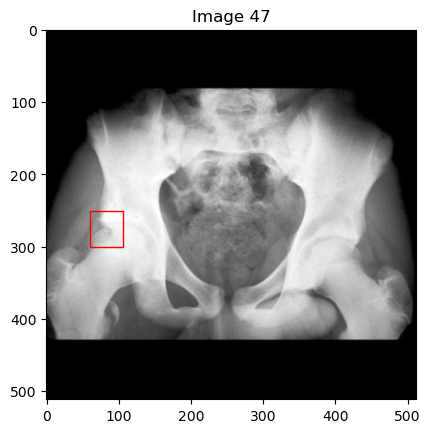

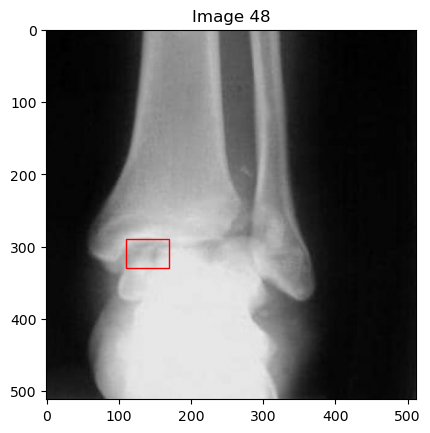

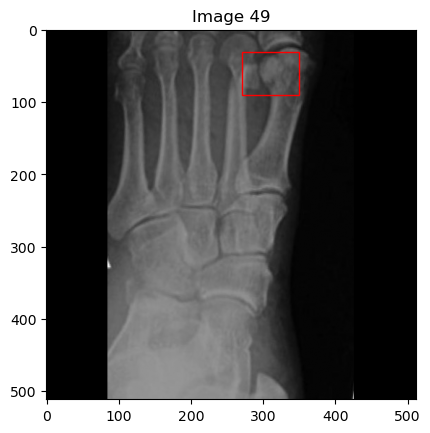

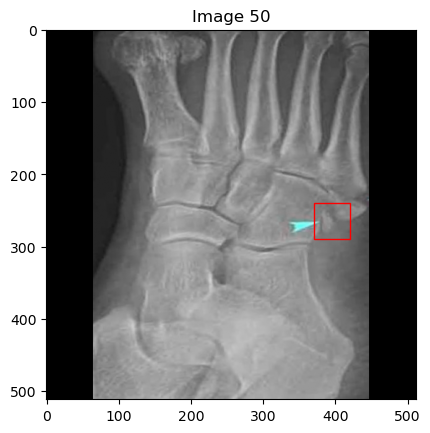

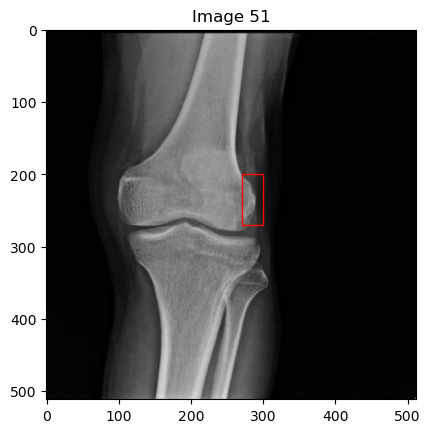

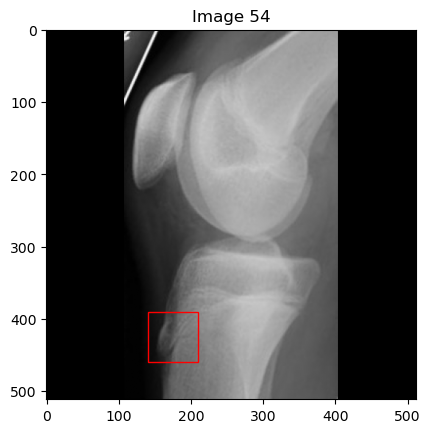

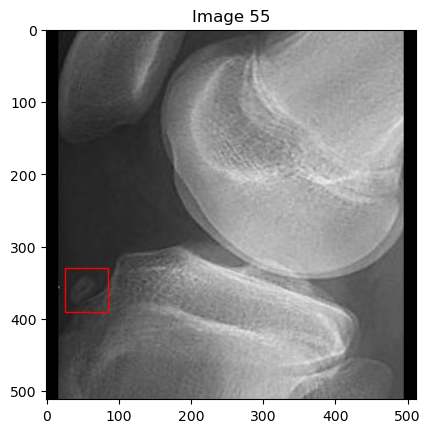

In [47]:
# Avulsion Fracture
# Test 84
bounding_box_test[42] = np.array([250, 230, 40, 50])
bounding_box_test[43] = np.array([280, 240, 70, 50])
bounding_box_test[46] = np.array([330, 160, 45, 70])
bounding_box_test[47] = np.array([60, 250, 45, 50])
bounding_box_test[48] = np.array([110, 290, 60, 40])
bounding_box_test[49] = np.array([270, 30, 80, 60])
bounding_box_test[50] = np.array([370, 240, 50, 50])
bounding_box_test[51] = np.array([270, 200, 30, 70])
bounding_box_test[54] = np.array([140, 390, 70, 70])
bounding_box_test[55] = np.array([25, 330, 60, 60])

plot_images_with_bb(42, 56, bounding_box_test, x_test)

### Develop Bounding Box Model

In [48]:
index1, index2 = np.nonzero(bounding_box)
X_train = x_train[np.unique(index1)]
Y_train = bounding_box[np.unique(index1)]

X_train, X_val, y_train, y_val = train_test_split(X_train, Y_train, test_size=0.1, random_state=42)

In [33]:
image_input = layers.Input(shape=(X_train.shape[1], X_train.shape[2], X_train.shape[3]))
x = layers.Conv2D(64, (3, 3), activation='relu')(image_input)
x = layers.MaxPooling2D((2, 2))(x)
x = layers.Conv2D(128, (3, 3), activation='relu')(x)
x = layers.MaxPooling2D((2, 2))(x)
x = layers.Flatten()(x)
x = layers.Dense(32, activation='relu')(x)
output = layers.Dense(4)(x)

In [34]:
model = models.Model(inputs=[image_input], outputs=output)
model.compile(optimizer='adam', loss='mean_absolute_error', metrics=['accuracy'])

In [36]:
checkpoint = ModelCheckpoint(os.path.join("models", "model1.keras"), monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

history = model.fit(X_train, y_train,
          batch_size=8,
          epochs=30,
          verbose=1,
          validation_data=(X_val, y_val),
          callbacks=[
             checkpoint
          ])

Epoch 1/30
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - accuracy: 0.3686 - loss: 111.8661
Epoch 1: val_accuracy improved from -inf to 0.57143, saving model to models/model1.keras
7/7 ━━━━━━━━━━━━━━━━━━━━ 62s 8s/step - accuracy: 0.3861 - loss: 108.4207 - val_accuracy: 0.5714 - val_loss: 77.8776
Epoch 2/30
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - accuracy: 0.8094 - loss: 53.9706
Epoch 2: val_accuracy did not improve from 0.57143
7/7 ━━━━━━━━━━━━━━━━━━━━ 49s 7s/step - accuracy: 0.7946 - loss: 54.4641 - val_accuracy: 0.4286 - val_loss: 57.7278
Epoch 3/30
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - accuracy: 0.7110 - loss: 51.8050
Epoch 3: val_accuracy did not improve from 0.57143
7/7 ━━━━━━━━━━━━━━━━━━━━ 51s 7s/step - accuracy: 0.7062 - loss: 51.7229 - val_accuracy: 0.4286 - val_loss: 48.9106
Epoch 4/30
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.6146 - loss: 58.1802
Epoch 4: val_accuracy did not improve from 0.57143
7/7 ━━━━━━━━━━━━━━━━━━━━ 77s 6s/step - accuracy: 0.6218 - loss: 57.4532 - val_accur

### Determine Missing Bounding Boxes from Model

In [75]:
def determine_bounding_box(model, bb_array, x):

    index = 0
    output = []
    
    for bb in bb_array:
        
        if not bb.any():
            y_pred = model.predict(x[index].reshape(1, 512, 512, 3))
            output.append(y_pred.astype(int)[0])
        else:
            output.append(bb)

        index += 1

    return np.array(output)

In [76]:
bounding_box_train_all = determine_bounding_box(model, bounding_box, x_train)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 661ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

In [78]:
bounding_box_test_all = determine_bounding_box(model, bounding_box_test, x_test)

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


### Crop Images to Bounding Boxes

In [87]:
def crop_images(bb, x):
    cropped_train_raw = []

    for i in range(len(bb)):
        
        x1 = int(bb[i][0])
        x2 = int(bb[i][2])
        y1 = int(bb[i][1])
        y2 = int(bb[i][3])
        
        cropped_train_raw.append(x[i][x1:x1+x2, y1:y1+y2])

    return cropped_train_raw

In [102]:
cropped_train_raw = crop_images(bounding_box_train_all, x_train)
cropped_test_raw = crop_images(bounding_box_test_all, x_test)

cropped_train = np.array([cv.resize(img, (128, 128)) for img in cropped_train_raw])
cropped_test = np.array([cv.resize(img, (128, 128)) for img in cropped_test_raw])

In [103]:
np.save("../data/bounding_boxes/bounding_boxes_train.npy", cropped_train)
np.save("../data/bounding_boxes/bounding_boxes_test.npy", cropped_test)